In [1]:
cd C:/Jade/thesis/data/Yu-Jie 11 strains 2/

C:\Jade\thesis\data\Yu-Jie 11 strains 2


In [2]:
pwd

'C:\\Jade\\thesis\\data\\Yu-Jie 11 strains 2'

In [3]:
pip list

Package                   Version
------------------------- --------------
anyio                     4.3.0
argon2-cffi               23.1.0
argon2-cffi-bindings      21.2.0
arrow                     1.3.0
asttokens                 2.4.1
async-lru                 2.0.4
attrs                     23.2.0
Babel                     2.14.0
beautifulsoup4            4.12.3
bleach                    6.1.0
certifi                   2024.2.2
cffi                      1.16.0
charset-normalizer        3.3.2
colorama                  0.4.6
comm                      0.2.2
contourpy                 1.2.1
cycler                    0.12.1
debugpy                   1.8.1
decorator                 5.1.1
defusedxml                0.7.1
exceptiongroup            1.2.0
executing                 2.0.1
fastjsonschema            2.19.1
fonttools                 4.51.0
fqdn                      1.5.1
h11                       0.14.0
httpcore                  1.0.5
httpx                     0.27.0
idna           

In [29]:
import pickle
import pandas as pd
from pathlib import Path
import tifffile as tiff
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
from scipy import interpolate
import scipy.ndimage
from skimage.draw import polygon2mask
from skimage.filters import threshold_otsu
from skimage import measure
from skimage.measure import regionprops_table, label
from skimage.draw import polygon2mask
from skimage.morphology import closing, erosion
from shapely.geometry import Polygon
from scipy.stats import zscore
import seaborn as sns
from matplotlib.patches import Patch
from scipy.stats import shapiro

<h2>Import feature data

In [30]:
pkl_file = 'C:/Jade/thesis/data/Yu-Jie 11 strains 2/AllData.pkl'
with open(pkl_file, "rb") as file:
  result_dataframes = pickle.load(file)

<h2> Unveiling gene-phenotype relationships through feature similarities 

<h3> Clustered median heatmap

In [5]:
# Robust scaling and display of dataset as phenotypic profile using a clustered median heatmap
# This Scaler scales the data according to the quantile range => not influenced by a small number of very large marginal outliers
from sklearn.preprocessing import RobustScaler
from matplotlib.patches import Patch

result_dataframes_median = result_dataframes.copy()

# Exclude 'tag' and 'strain' columns from robust Z-score transformation
numeric_columns = result_dataframes_median.select_dtypes(include=['number'])

scaler = RobustScaler()

robustZscore_transformed_numeric = scaler.fit_transform(numeric_columns)
robustZscore_transformed_numeric = pd.DataFrame(robustZscore_transformed_numeric)
robustZscore_transformed_numeric.columns = numeric_columns.columns

# Calculate the median of each column group by 'strain'
result_dataframes_median_grouped = robustZscore_transformed_numeric.groupby(result_dataframes_median['strain']).median()

# Reset index to make 'strain' a regular column
result_dataframes_median_grouped.reset_index(inplace=True)


## Heatmap
lut = {'BW25113': 'grey',
        'yfaQ': '#80b3ffff',
        'dacA': '#5599ffff',
        'yijD': '#0055d4ff',
        'yaaY': '#ff7f2aff',
        'nlpI': '#d45500ff',
        'lpp': '#ff2a2aff',
        'tolR': '#d40000ff',
        'wzzE': '#5fd38dff',
        'hdfR': '#32b867ff',
        'yifE': '#2ca05aff'}

row_colors = result_dataframes_median_grouped['strain'].map(lut)

result_dataframes_median_grouped2 = result_dataframes_median_grouped.drop(columns = ['strain'])

# Plot clustermap
sns.set_context('talk')
g = sns.clustermap(result_dataframes_median_grouped2,
                    metric='euclidean',
                   col_cluster=False,
                   cmap = "vlag",
                   row_colors = row_colors,
                   yticklabels=False,
                   vmin=-1, vmax=1, figsize=(250, 40))

# Move and adjust legend
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.72, .5, .01, .3))
g.fig.suptitle('Clustered median phenotypic profile', fontsize=150)
handles = [Patch(facecolor=lut[name]) for name in lut]
plt.legend(handles, lut, title='Strain',
           bbox_to_anchor=(1, 1), bbox_transform=plt.gcf().transFigure, loc='upper right', fontsize=150, title_fontsize=150)


plt.setp(g.ax_heatmap.get_xticklabels(), fontsize=150)  # Adjust font size of column labels


# Set font size for colorbar labels
g.cax.set_ylabel('Scaled feature value', fontsize=150)  # Set colorbar label size
g.cax.tick_params(labelsize=100)  # Set colorbar ticks size


plt.show()

<b> Correlation between features \
 Pearson <b>

The Pearson (product-moment) correlation coefficient is a measure of the linear relationship between two features. It is the ratio of the covariance of x and y to the product of their standard deviations.
* Each observation should have a pair of values.
* Each variable should be continuous.
* It should be the absence of outliers.
* It assumes linearity and homoscedasticity.

<b> Spearman <b> 

The Spearman correlation coefficient between two features is the Pearson correlation coefficient between their rank values. It is calculated the same way as the Pearson correlation coefficient, but takes into account their ranks instead of their values. 
* Each observation should have a pair of values.
* Each variable should be continuous.
* It should be the absence of outliers.
* It assumes linearity and homoscedasticity.

<b> Kendall <b> 

The Kendall correlation coefficient compares the number of concordant and discordant pairs of data. This coefficient is based on the difference in the counts of concordant and discordant pairs relative to the number of x-y pairs. 
* Pairs of observations are independent.
* Two variables should be measured on an ordinal, interval, or ratio scale.
* It assumes that there is a monotonic relationship between the two variables.

Comparison of Pearson correlation vs. Spearman and Kendall correlations 
* Non-parametric correlations are less powerful because they use less information in their calculations. In the case of Pearson's correlation uses information about the mean and deviation from the mean, while non-parametric correlations use only the ordinal information and scores of pairs.
* In the case of non-parametric correlation, it is possible that the X and Y values can be continuous or ordinal, and approximate normal distributions for X and Y are not required. But in the case of Pearson's correlation, it assumes the distributions of X and Y should have normal distribution and also be continuous.
* Correlation coefficients only measure linear (Pearson) or monotonic (Spearman and Kendall) relationships.

Spearman correlation vs. Kendall correlation:
* In the normal case, Kendall correlation is more robust and efficient than Spearman correlation. It means that Kendall correlation is preferred when there are small samples or some outliers.
* Spearman’s rho usually is larger than Kendall’s tau.
* The interpretation of Kendall’s tau in terms of the probabilities of observing the agreeable (concordant) and non-agreeable (discordant) pairs is very direct.


In [6]:
# Create the correlation
corr = robustZscore_transformed_numeric.corr(method='kendall')

# filter to check the most correlated variables to "the feature of interest"
corr["C2_cell_avg_obj_convexity"].sort_values(key=abs, ascending=False).head(20)

C2_cell_avg_obj_convexity                 1.000000
C2_object_avg_consDegree                 -0.604453
C2_cell_avg_obj_solidity                  0.506141
C2_cell_avg_obj_compactness              -0.496860
C2_cell_avg_obj_circularity               0.496519
C2_cell_avg_obj_perimeter                -0.495439
C2_obj_surface_area                      -0.471247
C2_cell_avg_obj_sphericity               -0.448789
C2_cell_avg_obj_eccentricity             -0.436033
C2_cell_avg_midline_sinuosity            -0.400818
C2_cell_avg_obj_width_variability        -0.395624
C2_cell_obj_midline_avg_bending_energy   -0.385127
C2_cell_avg_obj_aspectratio              -0.378917
C2_cell_avg_obj_width_dt                  0.342740
C2_cell_total_obj_mesh_length            -0.289759
C2_cell_total_obj_area                   -0.279568
C2_cell_total_obj_rect_length            -0.277350
C2_glcm_object_shannon_entropy           -0.273317
C2_cell_total_obj_volume                 -0.267944
C2_object_number               

In [27]:
# Define threshold threshold = 0.9  # Absolute value correlation matrix 
corr_matrix = corr.abs() 
corr_matrix.head()


,C2_NC_ratio,C2_avg_pole_object_distance,C2_cell_avg_midline_sinuosity,C2_cell_avg_obj_SOV,C2_cell_avg_obj_aspectratio,C2_cell_avg_obj_circularity,C2_cell_avg_obj_compactness,C2_cell_avg_obj_convexity,C2_cell_avg_obj_eccentricity,C2_cell_avg_obj_mean_c,...,cell_width_variability,C3_contour_homogeneity,C3_contour_intensity_kurtosis,C3_contour_intensity_skewness,C3_glcm_contour_contrast,C3_glcm_contour_correlation,C3_glcm_contour_dissimilarity,C3_glcm_contour_energy,C3_glcm_contour_homogeneity,C3_glcm_contour_shannon_entropy
C2_NC_ratio,1.000000,0.030913,0.245559,0.048668,0.371079,0.360423,0.360205,0.200972,0.368567,0.367685,...,0.061671,0.109047,0.075202,0.095357,0.013296,0.024625,0.016544,0.036576,0.041587,0.014613
C2_avg_pole_object_distance,0.030913,1.000000,0.104518,0.124451,0.314994,0.314587,0.315586,0.177997,0.327862,0.120344,...,0.035705,0.037645,0.035076,0.089792,0.077963,0.111538,0.132408,0.210608,0.175904,0.669620
C2_cell_avg_midline_sinuosity,0.245559,0.104518,1.000000,0.073690,0.390325,0.446519,0.446805,0.400818,0.415414,0.249011,...,0.133933,0.085999,0.061577,0.091838,0.045557,0.049069,0.013225,0.069434,0.020513,0.119449
C2_cell_avg_obj_SOV,0.048668,0.124451,0.073690,1.000000,0.313263,0.245244,0.245282,0.002479,0.280952,0.088632,...,0.103779,0.030969,0.089272,0.073096,0.106556,0.138541,0.110813,0.008200,0.104541,0.034268
C2_cell_avg_obj_aspectratio,0.371079,0.314994,0.390325,0.313263,1.000000,0.863056,0.862454,0.378917,0.921054,0.564920,...,0.179725,0.103047,0.033568,0.153395,0.022679,0.015547,0.077009,0.126435,0.123148,0.224129


In [28]:
# Upper triangle of correlations 
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool_)) 
upper.head()

,C2_NC_ratio,C2_avg_pole_object_distance,C2_cell_avg_midline_sinuosity,C2_cell_avg_obj_SOV,C2_cell_avg_obj_aspectratio,C2_cell_avg_obj_circularity,C2_cell_avg_obj_compactness,C2_cell_avg_obj_convexity,C2_cell_avg_obj_eccentricity,C2_cell_avg_obj_mean_c,...,cell_width_variability,C3_contour_homogeneity,C3_contour_intensity_kurtosis,C3_contour_intensity_skewness,C3_glcm_contour_contrast,C3_glcm_contour_correlation,C3_glcm_contour_dissimilarity,C3_glcm_contour_energy,C3_glcm_contour_homogeneity,C3_glcm_contour_shannon_entropy
C2_NC_ratio,NaN,0.030913,0.245559,0.048668,0.371079,0.360423,0.360205,0.200972,0.368567,0.367685,...,0.061671,0.109047,0.075202,0.095357,0.013296,0.024625,0.016544,0.036576,0.041587,0.014613
C2_avg_pole_object_distance,NaN,NaN,0.104518,0.124451,0.314994,0.314587,0.315586,0.177997,0.327862,0.120344,...,0.035705,0.037645,0.035076,0.089792,0.077963,0.111538,0.132408,0.210608,0.175904,0.669620
C2_cell_avg_midline_sinuosity,NaN,NaN,NaN,0.073690,0.390325,0.446519,0.446805,0.400818,0.415414,0.249011,...,0.133933,0.085999,0.061577,0.091838,0.045557,0.049069,0.013225,0.069434,0.020513,0.119449
C2_cell_avg_obj_SOV,NaN,NaN,NaN,NaN,0.313263,0.245244,0.245282,0.002479,0.280952,0.088632,...,0.103779,0.030969,0.089272,0.073096,0.106556,0.138541,0.110813,0.008200,0.104541,0.034268
C2_cell_avg_obj_aspectratio,NaN,NaN,NaN,NaN,NaN,0.863056,0.862454,0.378917,0.921054,0.564920,...,0.179725,0.103047,0.033568,0.153395,0.022679,0.015547,0.077009,0.126435,0.123148,0.224129


In [29]:
# Select columns with correlations above threshold
threshold = 0.9
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))
print(to_drop)
#detail => see excel

There are 12 columns to remove.
['C2_cell_avg_obj_compactness', 'C2_cell_avg_obj_eccentricity', 'C2_cell_total_obj_rect_length', 'C2_glcm_object_shannon_entropy', 'cell_area', 'cell_circularity', 'cell_compactness', 'cell_eccentricity', 'cell_length', 'cell_perimeter', 'cell_surface_area', 'cell_width']


In [30]:
#set y prediction from string to numeric
#drop correlation larger than threshold 0.9

data = robustZscore_transformed_numeric.copy()


# Create a mapping dictionary for the 'strain' column
strain_mapping = {
    "BW25113": 0,
    "dacA": 1,
    "lpp": 2,
    "tolR": 3,
    "yfaQ": 4,
    "yijD": 5,
    "hdfR": 6,
    "nlpI": 7,
    "wzzE": 8,
    "yaaY": 9,
    "yifE": 10
}


# Apply the mapping to the 'strain' column
y = result_dataframes['strain'].map(strain_mapping).to_frame()



# Apply the mapping to the 'strain' column
# y['strain'] = result_dataframes['strain'].map(strain_mapping)

x = data.drop(columns = to_drop)
# y = y.drop(columns = to_drop)

print('variable shape: ', x.shape)
print('response shape: ', y.shape)

print(to_drop)

variable shape:  (13903, 60)
response shape:  (13903, 1)
['C2_cell_avg_obj_compactness', 'C2_cell_avg_obj_eccentricity', 'C2_cell_total_obj_rect_length', 'C2_glcm_object_shannon_entropy', 'cell_area', 'cell_circularity', 'cell_compactness', 'cell_eccentricity', 'cell_length', 'cell_perimeter', 'cell_surface_area', 'cell_width']


In [31]:
# Delete high correlated features
## Heatmap
lut = {'BW25113': 'grey',
        'yfaQ': '#80b3ffff',
        'dacA': '#5599ffff',
        'yijD': '#0055d4ff',
        'yaaY': '#ff7f2aff',
        'nlpI': '#d45500ff',
        'lpp': '#ff2a2aff',
        'tolR': '#d40000ff',
        'wzzE': '#5fd38dff',
        'hdfR': '#32b867ff',
        'yifE': '#2ca05aff'}

row_colors = result_dataframes_median_grouped['strain'].map(lut)

result_dataframes_median_grouped2 = result_dataframes_median_grouped.drop(columns = ['strain'])

result_dataframes_median_grouped3 = result_dataframes_median_grouped2.drop(columns = to_drop)




# Plot clustermap
sns.set_context('talk')
g = sns.clustermap(result_dataframes_median_grouped3,
                    metric='euclidean',
                   col_cluster=False,
                   cmap = "vlag",
                   row_colors = row_colors,
                   yticklabels=False,
                   vmin=-1, vmax=1, figsize=(250, 40))

# Move and adjust legend
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.72, .5, .01, .3))
g.fig.suptitle('Clustered median phenotypic profile', fontsize=150)
handles = [Patch(facecolor=lut[name]) for name in lut]
plt.legend(handles, lut, title='Strain',
           bbox_to_anchor=(1, 1), bbox_transform=plt.gcf().transFigure, loc='upper right', fontsize=150, title_fontsize=150)


plt.setp(g.ax_heatmap.get_xticklabels(), fontsize=150)  # Adjust font size of column labels


# Set font size for colorbar labels
g.cax.set_ylabel('Scaled feature value', fontsize=150)  # Set colorbar label size
g.cax.tick_params(labelsize=100)  # Set colorbar ticks size


plt.show()

In [32]:
# Delete OM feaures
## Heatmap
lut = {'BW25113': 'grey',
        'yfaQ': '#80b3ffff',
        'dacA': '#5599ffff',
        'yijD': '#0055d4ff',
        'yaaY': '#ff7f2aff',
        'nlpI': '#d45500ff',
        'lpp': '#ff2a2aff',
        'tolR': '#d40000ff',
        'wzzE': '#5fd38dff',
        'hdfR': '#32b867ff',
        'yifE': '#2ca05aff'}

row_colors = result_dataframes_median_grouped['strain'].map(lut)

result_dataframes_median_grouped2 = result_dataframes_median_grouped.drop(columns = ['strain'])

result_dataframes_median_grouped3 = result_dataframes_median_grouped2.drop(columns = to_drop)

result_dataframes_median_grouped4 = result_dataframes_median_grouped3.drop(columns = ['C3_contour_homogeneity','C3_contour_intensity_kurtosis',
                                                                                      'C3_contour_intensity_skewness','C3_glcm_contour_contrast','C3_glcm_contour_correlation',
                                                                                      'C3_glcm_contour_dissimilarity','C3_glcm_contour_energy','C3_glcm_contour_homogeneity','C3_glcm_contour_shannon_entropy'])






 





# Plot clustermap
sns.set_context('talk')
g = sns.clustermap(result_dataframes_median_grouped4,
                    metric='euclidean',
                   col_cluster=False,
                   cmap = "vlag",
                   row_colors = row_colors,
                   yticklabels=False,
                   vmin=-1, vmax=1, figsize=(250, 40))

# Move and adjust legend
g.fig.subplots_adjust(right=0.7)
g.ax_cbar.set_position((0.72, .5, .01, .3))
g.fig.suptitle('Clustered median phenotypic profile', fontsize=150)
handles = [Patch(facecolor=lut[name]) for name in lut]
plt.legend(handles, lut, title='Strain',
           bbox_to_anchor=(1, 1), bbox_transform=plt.gcf().transFigure, loc='upper right', fontsize=150, title_fontsize=150)


plt.setp(g.ax_heatmap.get_xticklabels(), fontsize=150)  # Adjust font size of column labels


# Set font size for colorbar labels
g.cax.set_ylabel('Scaled feature value', fontsize=150)  # Set colorbar label size
g.cax.tick_params(labelsize=100)  # Set colorbar ticks size


plt.show()

<h3> Profile similarity

In [134]:
print(result_dataframes_median_grouped)

     strain  C2_NC_ratio  C2_avg_pole_object_distance   
0   BW25113    -0.318073                    -0.006263  \
1      dacA     0.178492                     0.115419   
2      hdfR     0.134579                    -0.049593   
3       lpp     0.005315                    -0.268769   
4      mlpI     0.261533                     0.019408   
5      tolR    -0.187043                    -0.211040   
6      wzzE     0.118460                    -0.099393   
7      yaaY    -0.037113                     0.088046   
8      yfaQ    -0.296627                     0.265394   
9      yifE     0.147507                     0.045478   
10     yijD    -0.209428                     0.246219   

    C2_cell_avg_midline_sinuosity  C2_cell_avg_obj_SOV   
0                             0.0             0.163829  \
1                             0.4            -0.406584   
2                             0.0             0.504165   
3                             0.0            -0.715123   
4                        

In [23]:
transposed_df = result_dataframes_median_grouped.T
print(transposed_df)

                                       0         1         2         3    
strain                            BW25113      dacA      hdfR       lpp  \
C2_NC_ratio                     -0.318073  0.178492  0.134579  0.005315   
C2_avg_pole_object_distance     -0.006263  0.115419 -0.049593 -0.268769   
C2_cell_avg_midline_sinuosity         0.0       0.4       0.0       0.0   
C2_cell_avg_obj_SOV              0.163829 -0.406584  0.504165 -0.715123   
...                                   ...       ...       ...       ...   
C3_glcm_contour_correlation      0.222298 -0.658166 -0.373889  0.572078   
C3_glcm_contour_dissimilarity   -0.187644   0.64407   0.42439 -0.574769   
C3_glcm_contour_energy          -0.008741 -0.559686 -0.120192  0.283435   
C3_glcm_contour_homogeneity      0.200711  -0.62319 -0.404464  0.587926   
C3_glcm_contour_shannon_entropy  0.067701  0.398832 -0.088296 -0.198199   

                                       4         5         6         7    
strain                  

In [24]:
column_names = result_dataframes_median_grouped['strain']  # Extract column names

data = transposed_df[1:]  # Extract data without the first row

# Create DataFrame using the data
result_dataframes_median_grouped_transposed = pd.DataFrame(data)

# Assign column names to the DataFrame
result_dataframes_median_grouped_transposed.columns = column_names


Statistic: 0.8741143941879272, p-value: 3.248408575018402e-06


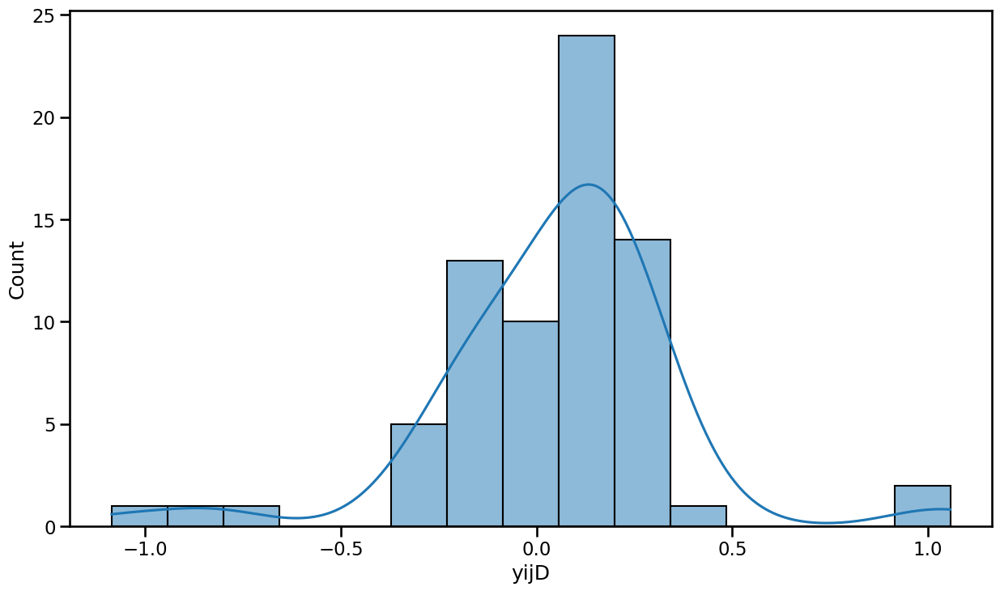

In [41]:
# Check normal distribution
filtered_data = result_dataframes_median_grouped_transposed['yijD']
sns.histplot(filtered_data, kde=True)

stat, p_value = shapiro(filtered_data)
print(f'Statistic: {stat}, p-value: {p_value}') # p-value <0.05 => not normal distribution

<AxesSubplot: xlabel='strain', ylabel='strain'>

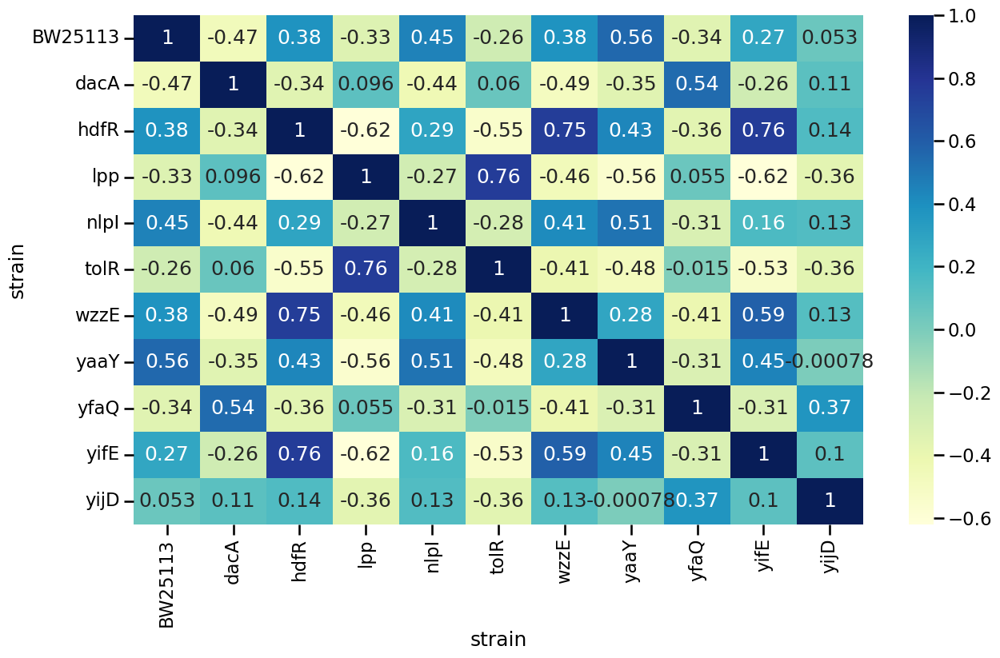

In [35]:
from pylab import rcParams
import seaborn as sb

corr = result_dataframes_median_grouped_transposed.corr(method='kendall') #You can choose pearson, spearman or kendall 

rcParams['figure.figsize'] = 14.7,8.27
sb.heatmap(corr, 
           xticklabels=corr.columns.values, 
           yticklabels=corr.columns.values, 
           cmap="YlGnBu",
          annot=True)

# strain list
#BW25113
#dacA
#lpp 
#tolR 
#yfaQ 
#yijD 
#hdfR
#mlpI 
#wzzE
#yaaY 
#yifE

# Feature list

In [5]:
result_dataframes['strain']

0        BW25113
1        BW25113
2        BW25113
3        BW25113
4        BW25113
          ...   
13898       yifE
13899       yifE
13900       yifE
13901       yifE
13902       yifE
Name: strain, Length: 13903, dtype: object

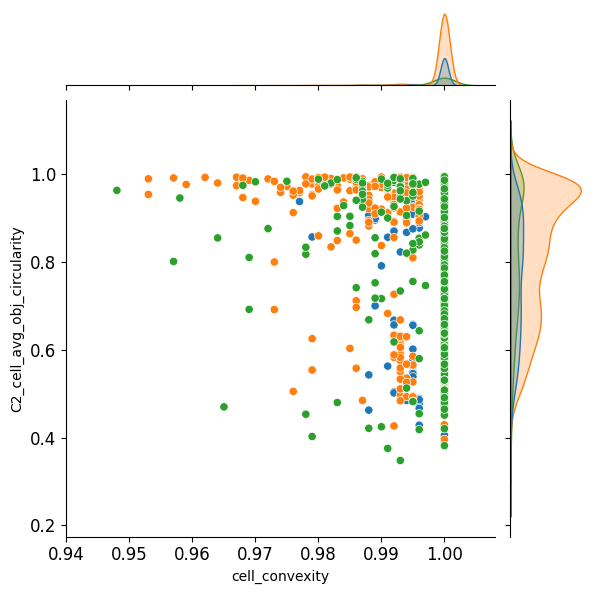

In [10]:
# Choose one visulaization

#1 all data points
data = result_dataframes

#2 Choose specific strain names
specific_strains = ['BW25113', 'tolR','lpp']  # Update with the desired strains
data = data[data['strain'].isin(specific_strains)]

#3 all meam/median grouped data point (original unit)
# numeric_columns = result_dataframes.select_dtypes(include=['number'])
# result_dataframes_mean = numeric_columns.groupby(result_dataframes['strain']).mean()
# data = result_dataframes_mean

# #change to log-log
# # Apply log-log transformation to each value in the DataFrame
# log_log_data = np.log(np.log(data))

# # Optionally, replace the original data with the transformed data
# data = log_log_data


#4 all mean/median grouped data points (after scaled)
# data = result_dataframes_mean_grouped
# data = result_dataframes_median_grouped







g = sns.jointplot(data=data, 
              x="cell_convexity", 
              y="C2_cell_avg_obj_circularity", 
                  
              # x="C2_cell_avg_obj_solidity", 
              # y="C2_cell_avg_obj_convexity", 
                  
              # x="cell_SOV", 
              # y="C2_cell_avg_obj_SOV", 
                  
              # x="cell_aspect_ratio", 
              # y="C2_cell_avg_obj_aspectratio", 
                  
              # x="C2_glcm_dissimilarity", 
              # y="C3_glcm_contour_dissimilarity", 
                  
              # x="C2_glcm_object_dissimilarity",    
              # y="C3_glcm_contour_dissimilarity",
                  
              # x="C2_glcm_object_homogeneity",    
              # y="C3_glcm_contour_homogeneity",
                  
              # x="C2_glcm_object_shannon_entropy",   
              # y="C3_glcm_contour_shannon_entropy",
                  
              hue='strain',
              legend=False)



# Set the size of x-axis scale labels
g.ax_joint.tick_params(axis='x', labelsize=12)

# Set the size of y-axis scale labels
g.ax_joint.tick_params(axis='y', labelsize=12)

plt.show()

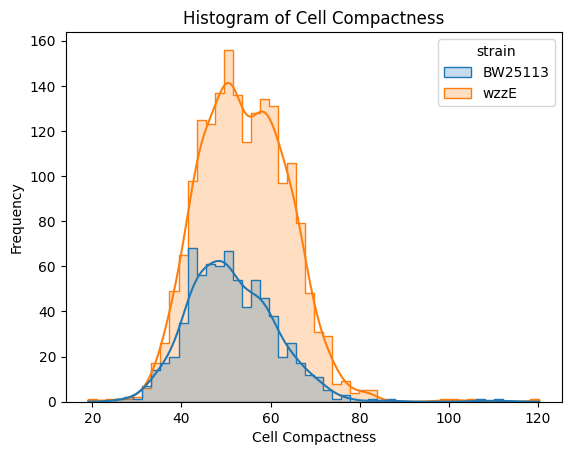

In [11]:
# Filter the data for the strains 'BW25113' and 'wzzE'
filtered_data = result_dataframes[result_dataframes['strain'].isin(['BW25113', 'wzzE'])]

# Plot histogram of 'cell_compactness' for both strains
sns.histplot(data=filtered_data, x='C2_cell_obj_contour_avg_bending_energy', hue='strain', kde=True, element='step')
plt.title('Histogram of Cell Compactness')
plt.xlabel('Cell Compactness')
plt.ylabel('Frequency')
plt.show()

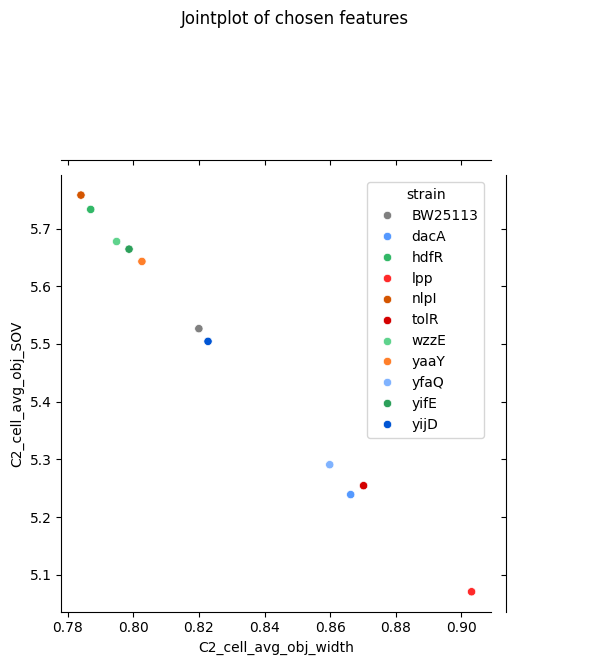

In [15]:
#1 all data points
data = result_dataframes

#2 Choose specific strain names
# specific_strains = ['BW25113', 'tolR']  # Update with the desired strains
# data = data[data['strain'].isin(specific_strains)]

#3 all meam/median grouped data point (original unit)
numeric_columns = result_dataframes.select_dtypes(include=['number'])
result_dataframes_mean = numeric_columns.groupby(result_dataframes['strain']).mean()
data = result_dataframes_mean


#4 all mean/median grouped data points (after scaled)
# data = result_dataframes_mean_grouped
# data = result_dataframes_median_grouped


# Define custom color palette
custom_palette = {
    'BW25113': 'grey',
    'yfaQ': '#80b3ffff',
    'dacA': '#5599ffff',
    'yijD': '#0055d4ff',
    'yaaY': '#ff7f2aff',
    'nlpI': '#d45500ff',
    'lpp': '#ff2a2aff',
    'tolR': '#d40000ff',
    'wzzE': '#5fd38dff',
    'hdfR': '#32b867ff',
    'yifE': '#2ca05aff'
}

# Assuming 'data' is your DataFrame containing the data
# Assuming 'strain' is a column in your DataFrame indicating the strain names

g = sns.jointplot(data=data, 
                  x="C2_cell_avg_obj_width",    
                  y="C2_cell_avg_obj_SOV",
                 

                  hue='strain',
                  palette=custom_palette)  # Use custom palette here
plt.suptitle("Jointplot of chosen features", y=1.1)
plt.show()


Normal distribution => Shapiro test

In [26]:
from scipy.stats import shapiro

filtered_df = result_dataframes.loc[result_dataframes['strain'] == 'BW25113', ['cell_width']]
data = filtered_df

w,pvalue = shapiro(data)
print(w, pvalue) # p-value <0.05 => not normal distribution

0.9702357649803162 3.804926859696245e-11


Homogeneity of variance => Levene’s test

In [27]:
from scipy.stats import levene

data = result_dataframes

# Group data by 'strain'
grouped_data = data.groupby('strain')

# Extract groups and convert them into a list of arrays
group_list = [group['C2_cell_avg_obj_convexity'].values for _, group in grouped_data]

# Perform Levene test
statistic, p_value = levene(*group_list)

# Print results
print("Levene Test Statistic:", statistic)
print("P-value:", p_value)

#p<0.05 => Groups have different variances

Levene Test Statistic: 50.8070736414514
P-value: 6.728087347043367e-101


Non-parametric ANOVA with post hoc tests =>Kruskal-Wallis test\
Compare the mean ranking of scores across three or more independent data samples.\
Samples can be of equal or different sizes.\
Determine if the samples originate from the same distribution.

In [18]:
from scipy.stats import kruskal

group_data = [result_dataframes.loc[ids, 'cell_width'].values for ids in result_dataframes.groupby('strain').groups.values()]

# Conduct the Kruskal-Wallis Test 
w,p = kruskal(*group_data)
 
# Print the result
print(p)



0.0


Non-parametric post-hoc test for multiple groups => Conover squared ranks test for equality of variance

In [20]:
import scikit_posthocs as sp
sp.posthoc_conover(result_dataframes, val_col='cell_compactness', group_col='strain', p_adjust = 'bonferroni')

,BW25113,dacA,hdfR,lpp,nlpI,tolR,wzzE,yaaY,yfaQ,yifE,yijD
BW25113,1.000000e+00,3.123389e-05,3.440104e-04,1.578754e-80,4.883444e-08,8.061627e-23,2.556485e-02,3.467715e-05,1.000000e+00,4.085641e-12,1.715527e-10
dacA,3.123389e-05,1.000000e+00,8.459763e-22,3.022815e-70,4.123377e-27,1.317638e-10,7.883367e-26,1.642811e-33,1.344090e-14,5.508503e-50,4.410355e-42
hdfR,3.440104e-04,8.459763e-22,1.000000e+00,4.299312e-124,1.000000e+00,2.414616e-44,1.000000e+00,1.000000e+00,7.152572e-02,1.000000e+00,1.000000e+00
lpp,1.578754e-80,3.022815e-70,4.299312e-124,1.000000e+00,2.257010e-118,3.532166e-06,7.512650e-212,1.488855e-219,1.034822e-145,1.620619e-248,1.863810e-205
nlpI,4.883444e-08,4.123377e-27,1.000000e+00,2.257010e-118,1.000000e+00,2.194111e-49,2.851569e-03,4.779390e-01,2.185937e-05,1.000000e+00,1.000000e+00
tolR,8.061627e-23,1.317638e-10,2.414616e-44,3.532166e-06,2.194111e-49,1.000000e+00,1.342507e-50,2.822508e-58,1.397676e-37,4.516547e-74,9.318068e-67
wzzE,2.556485e-02,7.883367e-26,1.000000e+00,7.512650e-212,2.851569e-03,1.342507e-50,1.000000e+00,1.000000e+00,1.000000e+00,5.429503e-06,1.156845e-04
yaaY,3.467715e-05,1.642811e-33,1.000000e+00,1.488855e-219,4.779390e-01,2.822508e-58,1.000000e+00,1.000000e+00,1.979328e-02,6.651292e-02,2.503203e-01
yfaQ,1.000000e+00,1.344090e-14,7.152572e-02,1.034822e-145,2.185937e-05,1.397676e-37,1.000000e+00,1.979328e-02,1.000000e+00,3.907322e-09,1.678701e-07
yifE,4.085641e-12,5.508503e-50,1.000000e+00,1.620619e-248,1.000000e+00,4.516547e-74,5.429503e-06,6.651292e-02,3.907322e-09,1.000000e+00,1.000000e+00


The Bonferroni test is a multiple-comparison correction used when several dependent or independent statistical tests are being performed simultaneously. The reason is that while a given alpha value may be appropriate for each individual comparison, it is not appropriate for the set of all comparisons. \
For example, an error rate of 5% might typically be assigned to a statistical test, meaning that 5% of the time there will likely be a false positive. This 5% error rate is called the alpha level. However, when many comparisons are being made in an analysis, the error rate for each comparison can impact the other results, creating multiple false positives.


posthoc_conover => Post hoc pairwise test for multiple comparisons of mean rank sums (Conover´s test). May be used after Kruskal-Wallis one-way analysis of variance by ranks to do pairwise comparisons 

(<Axes: >, <matplotlib.colorbar.Colorbar at 0x245b1a4c190>)

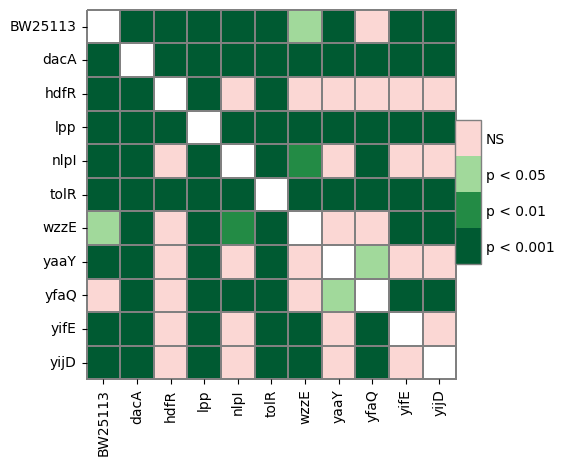

In [21]:
pc = sp.posthoc_conover(result_dataframes, val_col='cell_compactness', group_col='strain', p_adjust = 'bonferroni') #Benjamini/Hochberg = fdr_by
heatmap_args = {'linewidths': 0.25, 'linecolor': '0.5', 'clip_on': False, 'square': True, 'cbar_ax_bbox': [0.80, 0.35, 0.04, 0.3]}
sp.sign_plot(pc, **heatmap_args)

Non-parametric post-hoc test for multiple groups => Dunn-Bonferroni test for comparing the mean difference of numerous samples\
does not rely on assumptions about the distribution of the data.\
For simple comparisons, equal-size groups as well as unequal-size groups.\
'dunn.test' accounts for tied ranks

In [22]:
sp.posthoc_dunn(result_dataframes, val_col='cell_compactness', group_col='strain', p_adjust = 'bonferroni')

,BW25113,dacA,hdfR,lpp,nlpI,tolR,wzzE,yaaY,yfaQ,yifE,yijD
BW25113,1.000000e+00,2.162192e-04,1.691170e-03,1.984054e-69,8.538481e-07,1.833509e-19,6.837110e-02,2.364934e-04,1.000000e+00,2.753451e-10,6.757887e-09
dacA,2.162192e-04,1.000000e+00,1.378594e-18,1.850164e-60,3.784784e-23,5.391139e-09,4.775366e-22,1.185014e-28,2.057059e-12,7.162278e-43,4.844911e-36
hdfR,1.691170e-03,1.378594e-18,1.000000e+00,9.078670e-108,1.000000e+00,5.401155e-38,1.000000e+00,1.000000e+00,1.657334e-01,1.000000e+00,1.000000e+00
lpp,1.984054e-69,1.850164e-60,9.078670e-108,1.000000e+00,1.055135e-102,3.340575e-05,1.094040e-186,1.005051e-193,5.347674e-127,2.413656e-220,7.363674e-181
nlpI,8.538481e-07,3.784784e-23,1.000000e+00,1.055135e-102,1.000000e+00,2.367913e-42,1.038388e-02,8.529505e-01,1.592462e-04,1.000000e+00,1.000000e+00
tolR,1.833509e-19,5.391139e-09,5.401155e-38,3.340575e-05,2.367913e-42,1.000000e+00,2.110964e-43,4.699917e-50,3.694561e-32,8.578414e-64,2.013804e-57
wzzE,6.837110e-02,4.775366e-22,1.000000e+00,1.094040e-186,1.038388e-02,2.110964e-43,1.000000e+00,1.000000e+00,1.000000e+00,4.828184e-05,6.642507e-04
yaaY,2.364934e-04,1.185014e-28,1.000000e+00,1.005051e-193,8.529505e-01,4.699917e-50,1.000000e+00,1.000000e+00,5.486627e-02,1.556812e-01,4.879444e-01
yfaQ,1.000000e+00,2.057059e-12,1.657334e-01,5.347674e-127,1.592462e-04,3.694561e-32,1.000000e+00,5.486627e-02,1.000000e+00,9.821277e-08,2.458087e-06
yifE,2.753451e-10,7.162278e-43,1.000000e+00,2.413656e-220,1.000000e+00,8.578414e-64,4.828184e-05,1.556812e-01,9.821277e-08,1.000000e+00,1.000000e+00


(<Axes: >, <matplotlib.colorbar.Colorbar at 0x245b1b282e0>)

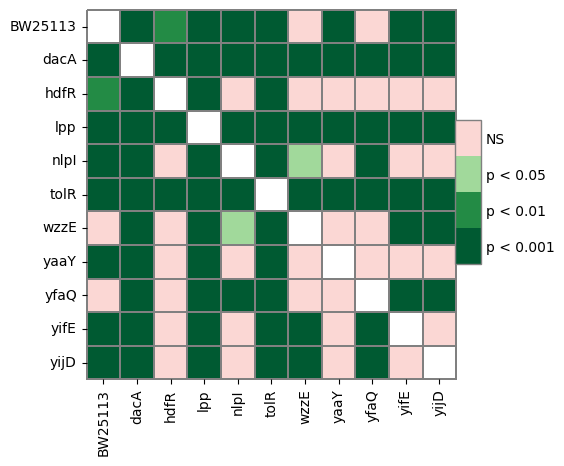

In [23]:
pc = sp.posthoc_dunn(result_dataframes, val_col='cell_compactness', group_col='strain', p_adjust = 'bonferroni') #Benjamini/Hochberg = fdr_by
heatmap_args = {'linewidths': 0.25, 'linecolor': '0.5', 'clip_on': False, 'square': True, 'cbar_ax_bbox': [0.80, 0.35, 0.04, 0.3]}
sp.sign_plot(pc, **heatmap_args)

C:\Users\jade\AppData\Local\Temp\ipykernel_29040\3600811777.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x="strain", y="C3_glcm_contour_contrast", palette=custom_palette)


<Axes: xlabel='strain', ylabel='C3_glcm_contour_contrast'>

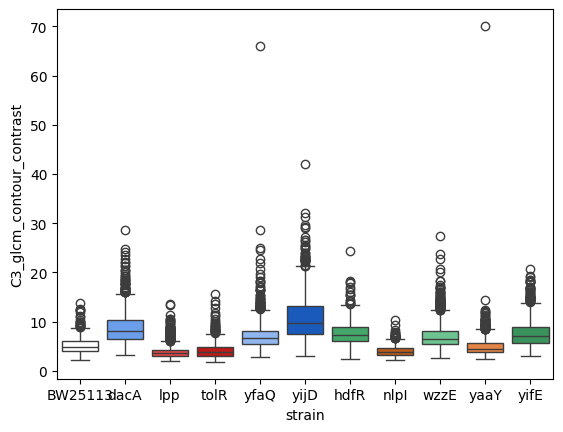

In [25]:
data = result_dataframes
data['strain'] = data['strain'].astype(str)
# print(data)

# Define custom color palette
custom_palette = {
    'BW25113': 'white',
    'yfaQ': '#80b3ffff',
    'dacA': '#5599ffff',
    'yijD': '#0055d4ff',
    'yaaY': '#ff7f2aff',
    'nlpI': '#d45500ff',
    'lpp': '#ff2a2aff',
    'tolR': '#d40000ff',
    'wzzE': '#5fd38dff',
    'hdfR': '#32b867ff',
    'yifE': '#2ca05aff'
}

sns.boxplot(data=data, x="strain", y="C3_glcm_contour_contrast", palette=custom_palette)


C:\Users\jade\AppData\Local\Temp\ipykernel_29040\2998701709.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(data=data, x="strain", y="C2_cell_obj_contour_avg_bending_energy", palette=custom_palette)


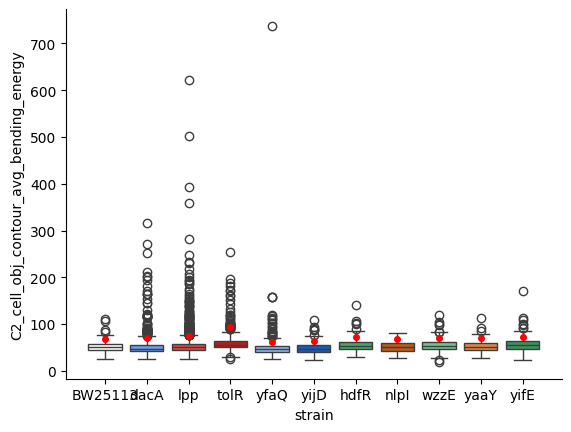

In [28]:

data = result_dataframes
data['strain'] = data['strain'].astype(str)
# print(data)

# Define custom color palette
custom_palette = {
    'BW25113': 'white',
    'yfaQ': '#80b3ffff',
    'dacA': '#5599ffff',
    'yijD': '#0055d4ff',
    'yaaY': '#ff7f2aff',
    'nlpI': '#d45500ff',
    'lpp': '#ff2a2aff',
    'tolR': '#d40000ff',
    'wzzE': '#5fd38dff',
    'hdfR': '#32b867ff',
    'yifE': '#2ca05aff'
}

# Create the boxplot with means
ax = sns.boxplot(data=data, x="strain", y="C2_cell_obj_contour_avg_bending_energy", palette=custom_palette)
                 
# Set the y-axis limit
# ax.set_ylim(0, 300)

# Remove the grid
sns.despine(ax=ax)
ax.grid(False)

# Calculate and plot the 95th percentile for each strain
strains = data['strain'].unique()
for i, strain in enumerate(strains):
    strain_data = data[data['strain'] == strain]['C2_cell_obj_contour_avg_bending_energy']
    pr95 = np.percentile(strain_data, 95)
    ax.plot(i, pr95, 'o', markersize=4, color='red')
    # ax.annotate(f'{pr95:.2f}', xy=(i, pr95), xytext=(i, pr95 + 10),
    #             ha='center', fontsize=15, color='red')

# Show the plot
plt.show()

C:\Users\jade\AppData\Local\Temp\ipykernel_29040\3290696509.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x="strain", y="cell_convexity", palette=custom_palette)


<Axes: xlabel='strain', ylabel='cell_convexity'>

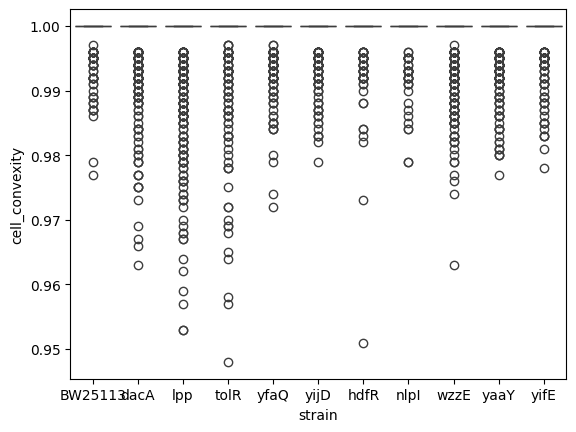

In [32]:
### Convexity number ###
sns.boxplot(data=data, x="strain", y="cell_convexity", palette=custom_palette)

C:\Users\jade\AppData\Local\Temp\ipykernel_29040\1849121461.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x="strain", y="cell_convexity_ordinal", palette=custom_palette)


<Axes: xlabel='strain', ylabel='cell_convexity_ordinal'>

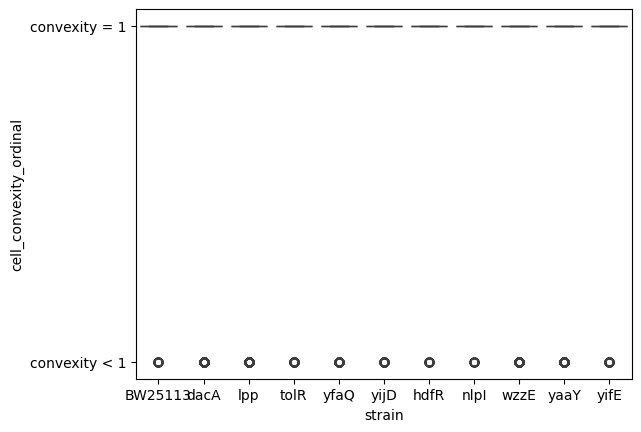

In [39]:
# Define the bins and labels
bins = [0, 1]
labels = ['convexity < 1',  'convexity = 1']

# Create a function to map the convexity values to labels
def map_convexity(convexity):
    if convexity == 1:
        return 'convexity = 1'
    
    else:
        return 'convexity < 1'

# Apply the mapping function to create the new column
data['cell_convexity_ordinal'] = data['cell_convexity'].apply(map_convexity)

# Now you can use sns.boxplot with the new column
sns.boxplot(data=data, x="strain", y="cell_convexity_ordinal", palette=custom_palette)

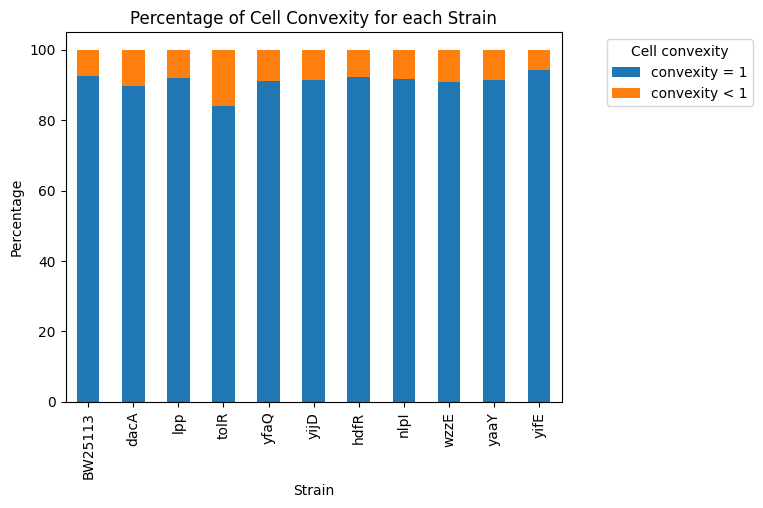

In [40]:
# Calculate the percentage of each strain for each value of "cell_convexity_ordinal"
percentage = data.groupby(['strain', 'cell_convexity_ordinal']).size().unstack(fill_value=0).apply(lambda x: x / x.sum(), axis=1)

# Reset index to make 'strain' a regular column
percentage.reset_index(inplace=True)

# Define the order of strains as desired
strain_order = ['BW25113', 'dacA', 'lpp', 'tolR', 'yfaQ', 'yijD', 'hdfR', 'nlpI', 'wzzE', 'yaaY', 'yifE']

# Convert the values in the DataFrame to percentages
percentage.iloc[:, 1:] *= 100  # Assuming the columns from 1 onwards represent percentages

# Reorder the columns based on the desired order
column_order = ['convexity = 1', 'convexity < 1']
percentage = percentage[['strain'] + column_order]

# Reorder the DataFrame based on the categorical order of 'strain'
percentage['strain'] = pd.Categorical(percentage['strain'], categories=strain_order, ordered=True)
percentage_sorted = percentage.sort_values('strain')

# Plot the stacked bar plot with the sorted DataFrame
ax = percentage_sorted.set_index('strain').plot(kind='bar', stacked=True)
ax.set(xlabel='Strain', ylabel='Percentage', title='Percentage of Cell Convexity for each Strain')
ax.legend(title='Cell convexity', loc='upper right', bbox_to_anchor=(1.4, 1))

<h3>Dimension reduction and visualization

<h4> Preparation of data for dimension reduction

In [43]:
n_strains = len(result_dataframes['strain'].unique())
print(n_strains)

11


In [44]:
from sklearn.preprocessing import StandardScaler, RobustScaler

# Select data for following plots
n_conditions = len(result_dataframes['strain'].unique())

# Robust scale numeric data
df_numeric = result_dataframes.select_dtypes(np.number)
print(df_numeric.head())

#robust scaling ## you can choose or not
# scaler = RobustScaler()
# robustZscore_transformed_numeric = scaler.fit_transform(df_numeric)
# robustZscore_transformed_numeric = pd.DataFrame(robustZscore_transformed_numeric)
# print(robustZscore_transformed_numeric.head())


   C2_NC_ratio  C2_avg_pole_object_distance  C2_cell_avg_midline_sinuosity   
0     0.633211                     1.642329                          1.001  \
1     0.536196                     1.566326                          1.005   
2     0.536852                     1.343396                          1.000   
3     0.622640                     1.633153                          1.013   
4     0.555826                     1.005853                          1.000   

   C2_cell_avg_obj_SOV  C2_cell_avg_obj_aspectratio   
0             5.137698                     2.926664  \
1             5.229720                     2.535428   
2             5.781618                     2.469550   
3             4.849063                     2.707568   
4             4.735311                     1.509061   

   C2_cell_avg_obj_circularity  C2_cell_avg_obj_compactness   
0                     0.620693                    20.245726  \
1                     0.730817                    17.194952   
2          

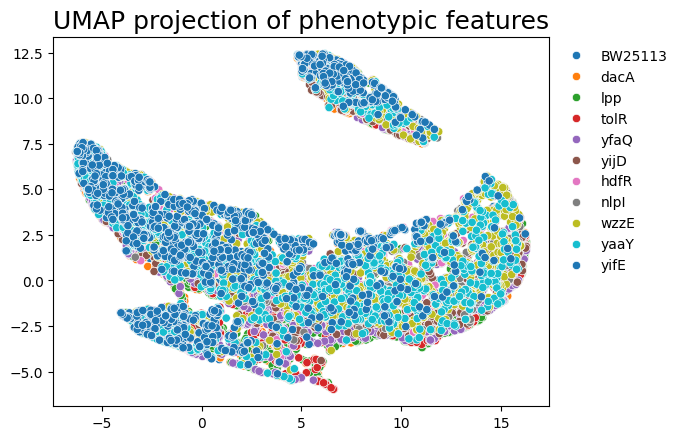

In [45]:
import umap
# Initializing the UMAP instance
reduce_umap = umap.UMAP()

# Train the reducer to create embedding
embedding_umap = reduce_umap.fit_transform(df_numeric)

# Plot embedding as scatterplot
ax = sns.scatterplot(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    hue=result_dataframes.strain,
    palette=sns.color_palette("tab10", n_colors=n_strains))

plt.title('UMAP projection of phenotypic features', fontsize=18)

leg = ax.legend(frameon=False)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.show()

ML classification

Preparation of data for classification

In [44]:

pkl_file = 'C:/Jade/thesis/data/Yu-Jie 11 strains 2/AllData.pkl'
with open(pkl_file, "rb") as file:
  result_dataframes = pickle.load(file)


# Create a binary target column for whether the condition is "Control" or not
result_dataframes['strain'] = (result_dataframes['strain'] == 'BW25113').astype(int)

# Split the data into features and target
X = result_dataframes.drop(columns=['strain']).select_dtypes(include=[np.number])
y = result_dataframes['strain']

Train the LDA classifier and use GridSearchCV to find hyperparamters

Best Hyperparameters: {'classifier__solver': 'svd'}


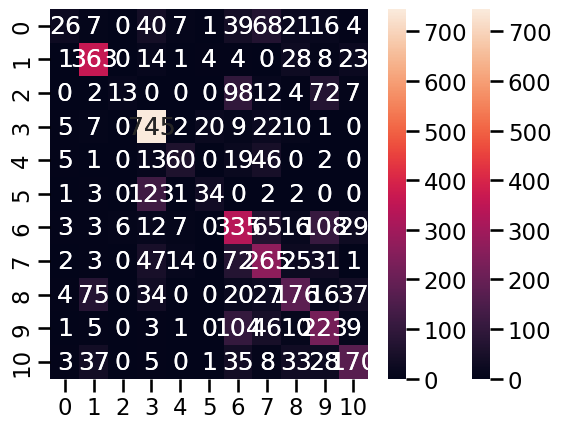

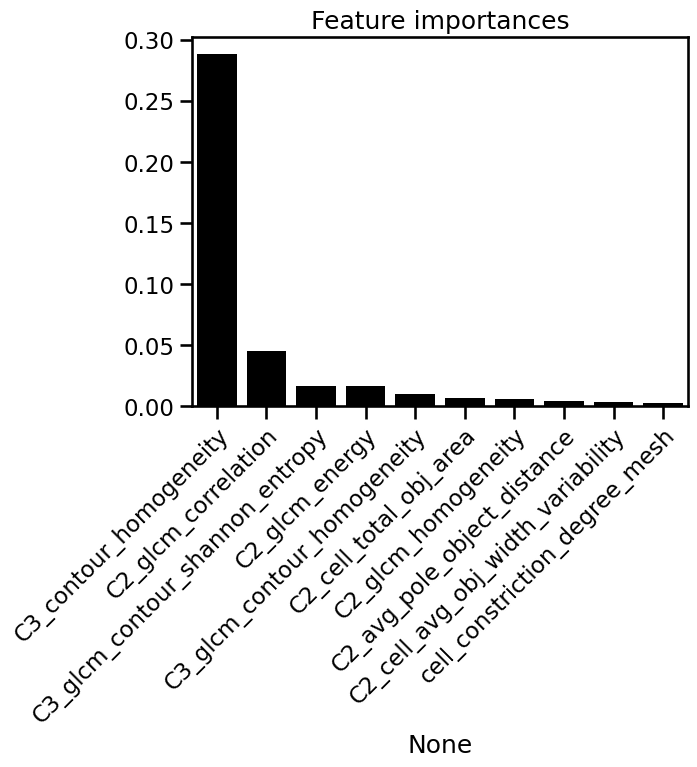

In [45]:

# Import the necessary libraries
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
import joblib

saving_path_classif = 'C:/Jade/thesis/data/Yu-Jie 11 strains 2/'


# Create the pipeline for preprocessing and classification
pipeline = Pipeline([
    ('classifier', LinearDiscriminantAnalysis())  #('scaler', StandardScaler()),
])

# Define the hyperparameter search space
param_grid = {'classifier__solver': ['svd', 'lsqr']}

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, 
                                                    random_state=42, stratify=y)

# Use grid search cross-validation to find the best hyperparameters
grid_search = GridSearchCV(pipeline, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Print the best hyperparameters found
print("Best Hyperparameters:", grid_search.best_params_)

# Train the pipeline on the full training set with the best hyperparameters
pipeline.set_params(**grid_search.best_params_)
pipeline.fit(X_train, y_train)

# Save the pipeline 
joblib.dump(pipeline, saving_path_classif + 'LDA_classifier_pipeline.joblib')

# Get and plot feature importances
def plot_feature_importances(model, feature_names, top_n):
    model = model.named_steps["classifier"]

    importances = model.coef_[0]
    # Normalize the importances
    importances = importances / np.sum(np.abs(importances))

    indices = np.argsort(importances)[::-1][:top_n]
    plt.figure()
    sns.barplot(x=feature_names[indices], y=importances[indices], color="black")
    plt.title("Feature importances")
    plt.xticks(rotation=45, ha='right', rotation_mode='anchor')
    plt.savefig(saving_path_classif + 'FeatureImportances_LDA.pdf', bbox_inches='tight')
    plt.show()


plot_feature_importances(pipeline, X.columns, top_n=10)




Evaluate trained LDA classifier on test set


       strain  True Control  Pred Control  Control Prob
1458        0             0             0      0.000708
13439       0             0             0      0.032386
300         1             1             0      0.190792
5919        0             0             0      0.013601
7473        0             0             0      0.003884
...       ...           ...           ...           ...
3846        0             0             0      0.010901
11560       0             0             0      0.154564
11609       0             0             0      0.049207
7713        0             0             0      0.025444
7035        0             0             0      0.023977

[1391 rows x 4 columns]
Accuracy on test set: 0.9518332135154565


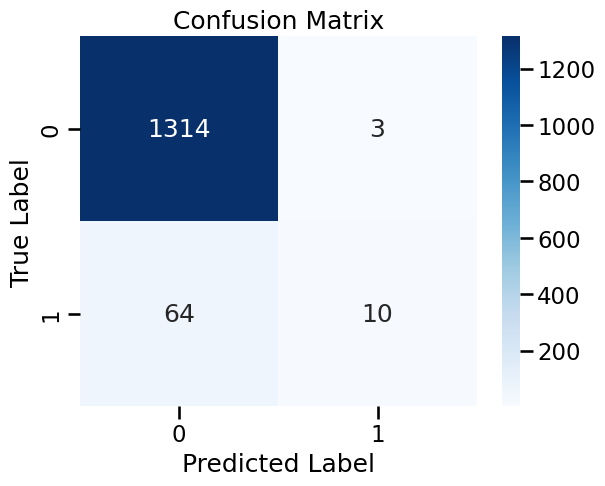

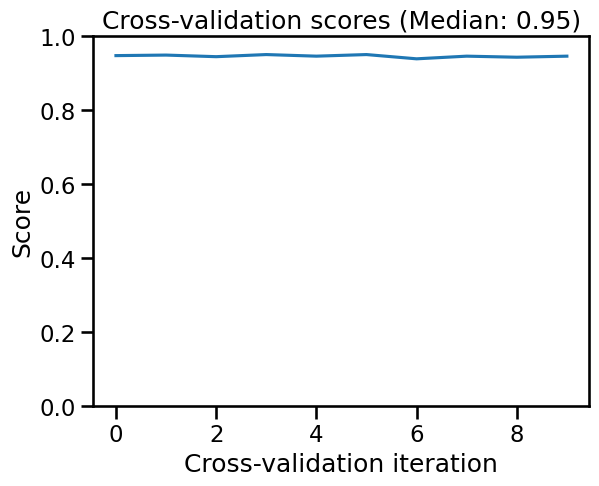

In [46]:
from sklearn.metrics import accuracy_score, confusion_matrix

# Make predictions on the test set and get the probabilities of each sample belonging to the "Control" class
y_pred = pipeline.predict(X_test)
y_probs = pipeline.predict_proba(X_test)[:, 1]

# Add the true condition labels to the results for comparison
results = pd.DataFrame({'strain': result_dataframes.loc[X_test.index, 'strain'],
                        'True Control': y_test,
                        'Pred Control': y_pred,
                        'Control Prob': y_probs})
print(results)

# Save results as table
# results.to_csv(saving_path_classif + 'Test_set_classification_LDA.csv')

# Evaluate the accuracy of the classifier on the test set
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on test set:", accuracy)

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d")
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.savefig(saving_path_classif + 'Confusion_Matrix_LDA.pdf', bbox_inches='tight')
plt.show()

# Plot the cross-validation scores accross the whole dataset
scores = cross_val_score(pipeline, X, y, cv=10)
sns.lineplot(data=scores)
plt.xlabel("Cross-validation iteration")
plt.ylabel("Score")
plt.ylim(0, 1)
median_score = np.median(scores)
plt.title(f"Cross-validation scores (Median: {median_score:.2f})")
plt.savefig(saving_path_classif + 'CV_scores_LDA.pdf', bbox_inches='tight')
plt.show()